<!--start-block-->
<hr style="height: 1px;">
<i>This notebook was authored by the 8.316 Course Team, Copyright 2023 MIT All Rights Reserved.</i>
<hr style="height: 1px;">
<br>

<h1>PSet 4: Simulation</h1>

<br>

<!--start-block MIT color #A31F34-->
<a name='section_4_0'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.0 Overview</h2>

<h3>Navigation</h3>
          
<table style="width:100%">
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_4_1">P1.1 Random Variables and Probability Density Functions</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#exercises_4_2">P1.1 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_1_2">P1.2 Gaussian Distribution</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#exercises_1_2">P1.2 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_1_3">P1.3 Joint Probability Density Functions</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#exercises_1_3">P1.3 Problems</a></td>
   </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_1_4">P1.4 Poisson Distribution</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#exercises_1_4">P1.4 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_1_5">P1.5 Simulating a Poisson Process</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#exercises_1_5">P1.5 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_1_6">P1.6 Exponential Distribution (Optional)</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#exercises_1_6">P1.6 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_2_1">P1.7 Error Propagation - A Simple Example</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_2_1">P1.7 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_2_2">P1.8 Error Propagation - A More Complicated Example</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_2_2">P1.8 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_2_3">P1.9 Johnson Noise</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_2_3">P1.9 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_3_1">P1.10 Frequency Analysis</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_3_1">P1.10 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_3_2">P1.11 The Discrete Fourier Transform</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_3_2">P1.11 Problems</a></td>
    </tr>
    <tr>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#section_3_3">P1.12 Spectrogram and Q-Transform</a></td>
        <td style="text-align: left; vertical-align: top; font-size: 10pt;"><a href="#problems_3_3">P1.12 Problems</a></td>
    </tr>
</table>

<h3>Learning Objectives</h3>

This problem set is aimed at building intuition for the understanding of random variables, and for the application of statistical tools in understanding physics datasets. We will focus on the tools used within the lectures, but here we will expand on them with longer problems that illustrate what's going on. 


In this problem set we will explore the following topics:

- Introduction to random variables and their distributions
- Introduction to the properties of a Gaussian distribution
- Introduction to joint probability distributions of more than one variable
- Introduction to the properties of a Poisson distribution
- Examples of how a Poisson distribution arises in simulated data
- Discussion of why the time between events in a Poisson distribution gives an exponential distribution

2D Ideal Gas Law through Particle Simulation

The goal of this section is to derive macroscopic physical laws microscopic particle level simulation, 
and we will derive famous relations such as Boltzmann distribution, Entropy, Charles' law, Boyle's law, and Ideal gas Relation

<h3>Importing Libraries</h3>

Before beginning, run the cell below to import the relevant libraries for this notebook.

In [1]:
%matplotlib inline
import itertools
from IPython.display import HTML
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.animation import PillowWriter

<h3>Setting Default Figure Parameters</h3>

The following code cell sets default values for figure parameters.

In [2]:
#>>>RUN: P1.0-runcell02

#set plot resolution
%config InlineBackend.figure_format = 'retina'

#set default figure parameters
plt.rcParams['figure.figsize'] = (9,6)

medium_size = 12
large_size = 15

plt.rc('font', size=medium_size)          # default text sizes
plt.rc('xtick', labelsize=medium_size)    # xtick labels
plt.rc('ytick', labelsize=medium_size)    # ytick labels
plt.rc('legend', fontsize=medium_size)    # legend
plt.rc('axes', titlesize=large_size)      # axes title
plt.rc('axes', labelsize=large_size)      # x and y labels
plt.rc('figure', titlesize=large_size)    # figure title

<!--start-block-->
<a name='section_4_1'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.1 Obtaining Maxwell-Boltzmann distribution from Molecular Simulation</h2>

| [Top](#section_4_0) | [Problems](#exercises_4_1) | [Next Section](#section_4_2) |

<h3>Overview</h3>

In this section, you will code the microscopic simulation of ideal gas, where the particles move freely inside a stationary container without interacting with one another, except for very brief collisions in which they exchange energy and momentum with each other or with their thermal environment. 

Then we will derive $\href{https://en.wikipedia.org/wiki/Maxwell%E2%80%93Boltzmann_distribution}{\text{Maxwell-Boltzmann distribution}}$, which describes velocity distribution of these idela gas particles, using this microscopic simulations. 

Maxwell-Boltzmann Distribution
Let's look at the final velocity distribution of the particles and compare it to Maxwell-Boltzmann in 2 Dimensions:

* $kT = KE_{avg} = \frac{1}{2}m\bar{v^2} \implies \boxed{\frac{m}{kT} = \frac{2}{\bar{v^2}}}$
* $\boxed{f(v) = \frac{m}{kT} v \exp\left(-\frac{m}{kT}\frac{v^2}{2} \right)}$


In [3]:
# BOX SIZE 1 by 1 in 2 dimensions

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.1</span>

Elastic Collision with the wall. (Add a diagram)

We know that for elastic collsion of a mass with a wall (stationary infinite mass object), the velocity component perpendicular to the wall flips direction.

(Include Formula)

Complete the code for `wall_collision`, which takes as input `pos` and `vel` that represents position and velocity vectors of particles, and returns the velocity vectors 
after the collsion with four sides of the wall. Assume that both `pos` and `vel` have shape `[n_particles, 2]` 

In [4]:
def wall_collision(pos, vel):
    # Your code goes here. 
    #collsion with the right wall 
    vel[pos[:, 0] > 1, 0] = -np.abs(vel[pos[:, 0] > 1, 0])

    #collision with the left wall 
    vel[pos[:, 0] < 0, 0] = np.abs(vel[pos[:, 0] < 0, 0])

    #collision with the top wall 
    vel[pos[:, 1] > 1, 1] = -np.abs(vel[pos[:, 1] > 1, 1])

    #collsion with the bottom wall 
    vel[pos[:, 1] < 0, 1] = np.abs(vel[pos[:, 1] < 0, 1])
    return vel 

<h3>Let's run a simulation of a single particle bouncing off four side of the walls using the above code you completed. </h3>

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.2</span>

Single particle simulation. 

We will simulate in time steps `dt`. 

First, in each time step, we handle the wall collision of the particle, and flip the component of the velocity vector using function `wall_collision` we coded above. 

Then, we use the position update formula $$\vec{x}_{i+1} = \vec{x}_{i} + dt \cdot \vec{v}_{i+1}$$, which is discretizing the continuous relation $$\vec{v} = d\vec{x}/dt $$

We save all the simulated position and velocity vectors in arrays of shape `[time_steps, 2]`.




Enter the x component of the position of the following particle in step 1111 rounded to 2 significant digits. 

In [5]:
# Your code here
def simulate_wall(pos, vel, time_steps, dt):
    n_particles = pos.shape[0]
    pos_simulated = np.zeros((time_steps,n_particles, 2))
    vel_simulated = np.zeros((time_steps,n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel
    
    for i in range(1,time_steps):
        vel = wall_collision(pos, vel)
        pos = pos + vel * dt    
        vel_simulated[i] = vel
        pos_simulated[i] = pos
        
    return pos_simulated, vel_simulated

#pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)
#print(pos_sim[1111][0])

In [6]:
pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)

In [7]:
pos_sim.shape

(8000, 1, 2)

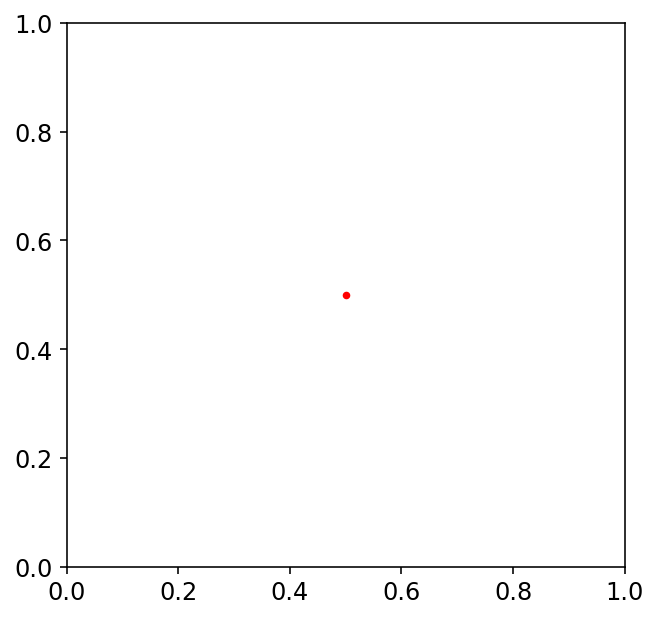

In [15]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.clear()
vmin = 0
vmax = 1
ax.set_xlim(0,1)
ax.set_ylim(0,1)
markersize = 2 * 0.005 * ax.get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = ax.plot([], [], 'o', color='red', markersize=markersize)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    return [red]


ani = animation.FuncAnimation(fig, animate, frames=500, interval=50, blit=True)

In [16]:
HTML(ani.to_jshtml())


<h3> Interparticle Collisions </h3>

Now let's write code that handles interparticle collisions. 

The ideal gas molecules doesn't interact with one another except for very brief collisions in which they exchange energy and momentum with each other or with their thermal environment. For ideal gas, these collisions will be elastic collsions. 



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.1</span>

When two particles get closer 2 times the radius of the particle, we should perform elastic collision of particles. 

For simulation, we need to track in each simulation step which pair of particles collide. In order to detect collision, first we have to calculate the center of mass distances between each particles. 

For bookkeeping indices, we give `n_particles` indices `0,1,...,n_particles-1`. 

Given position vectors `position` of shape `[n_particles, 2]` and an array of index pair `idx_pair` of shape `[n_pair, 2]` where each row is `[index_particle1, index_particle2]`, write a function that computes an array of shape `[n_pair]`, which is a pairwise distance of particles between each index pair of particles.  

For a given position and idx_pair arrays, enter the resulting distance_pairs vectors' 0, 23, 234, 444th entry. 

In [17]:
# helper function that calculates distance between particles of given index pair
# maybe turn that into problem?
def compute_distance_pairs(position, idx_pair):
    delta_x = position[:,0][idx_pair][:,0] - position[:,0][idx_pair][:,1]
    delta_y = position[:,1][idx_pair][:,0] - position[:,1][idx_pair][:,1]
    return np.sqrt(delta_x**2 + delta_y**2)


np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))
compute_distance_pairs(pos_initial, idx_pair)[[0,23,234,444]]
#inditial position of particles
#np.random.seed(908)


array([0.30366182, 0.72319803, 0.44839845, 0.43339836])

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.1</span>

Now, given a distance pair array for a given index pairs, we need to calculate which pairs actually collide, meaning they satisfy the condition that the center of mass distance between a pair of particles is smaller than `2*particle_radius`

Write a simple function that takes as an input `distance_pairs` and returns an array of indices of `idx_pairs` of pairs that collide.
Enter indices of pairs that collide. 

In [18]:
def which_pair_collides(distance_pairs):
    return np.where(distance_pairs < 2*particle_radius)[0]
    #return distance_pairs < 2*particle_radius

particle_radius = 0.01
distance_pairs = compute_distance_pairs(pos_initial, idx_pair)
which_pair_collides(distance_pairs)

array([194, 610, 772])

In [19]:
#For simulation, we need to track in each simulation step which pair of particles collide. In order to detect collision, we use 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.1</span>

Elastic Collsion of Particles. 

When two particles get closer 2 times the radius of the particle, we should perform elastic collision of particles. 

So at each iteration of the simulation, we will evaluate `d_pairs`, and if any of the distances between particles is less than $2r$, then a collision occurs. What is the final velocity of each of the two spheres? In an elastic collision (conservation of energy + momentum + angular momentum), one can show

$$\vec{v}_1^{\text{new}} = \vec{v}_1 - \frac{(\vec{v}_1 - \vec{v}_2) \cdot (\vec{r}_1 - \vec{r}_2)}{|\vec{r}_1 - \vec{r}_2|^2} (\vec{r}_1 - \vec{r}_2)$$
$$\vec{v}_2^{\text{new}} = \vec{v}_2 - \frac{(\vec{v}_2 - \vec{v}_1) \cdot (\vec{r}_2 - \vec{r}_1)}{|\vec{r}_1 - \vec{r}_2|^2} (\vec{r}_2 - \vec{r}_1)$$

You can use your function in the ungraded "follow-up" part of this problem.

Complete the code for `pair_collsion`, which takes as input `pos_1i`, `pos_2i`, `vel_1i` and `vel_2i` that represents position and velocity vectors of particles, and returns the velocity vectors 
after the collsion with four sides of the wall.

For given particles that collide, enter x, y velocity components of the first particle.

In [20]:
def pair_collision(pos_1i, pos_2i, vel_1i, vel_2i):

    vel_1f = vel_1i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/np.sum((pos_1i-pos_2i)**2, axis=1)).T @ (pos_1i - pos_2i)
    vel_2f = vel_2i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/np.sum((pos_1i-pos_2i)**2, axis=1)).T @ (pos_2i - pos_1i)
    
    #vel_1f = vel_1i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/(np.ones(pos_1i.shape[0])*4*particle_radius*particle_radius)) @ (pos_1i - pos_2i)
    #vel_2f = vel_2i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/(np.ones(pos_1i.shape[0])*4*particle_radius*particle_radius)) @ (pos_2i - pos_1i)

    return vel_1f, vel_2f



    

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 1.2.1</span>

Full simulation.
Let's edit the `simulate` function we coded earlier to incorporate all particlewise collisions. 

`idx_pair` keeps pairs of every possible pair of indices

For a given position and idx_pair arrays, enter the resulting distance_pairs vectors' 0, 23, 234, 444th entry. 

In [21]:
#pair_collision(pos_initial[idx_pair[wpc][:,0]], pos_initial[idx_pair[wpc][:,1]],vel_initial[idx_pair[wpc][:,0]],vel_initial[idx_pair[wpc][:,1]])

In [22]:
def simulate(pos, vel, time_steps, dt):

    
    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    
    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))


    

    
    pos_simulated[0] = pos
    vel_simulated[0] = vel
    
    for i in range(1,time_steps):


        collision_idx = which_pair_collides(compute_distance_pairs(pos, idx_pair))
        v1f, v2f = pair_collision(pos[idx_pair[collision_idx][:,0]], pos[idx_pair[collision_idx][:,1]],
                                  vel[idx_pair[collision_idx][:,0]], vel[idx_pair[collision_idx][:,1]])

        vel[idx_pair[collision_idx][:,0]] = v1f
        vel[idx_pair[collision_idx][:,1]] = v2f

        vel = wall_collision(pos, vel)

        pos = pos + vel * dt
        

        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated

<h3>Setting Parameters of our Simulation</h3>

In [23]:
np.random.seed(4150032420)
n_particles = 65 #number of particles
pos_initial = np.random.rand(n_particles, 2) #inditial position of particles
particle_radius = 0.003 #radius of individual particles
L = 1 #side length of the box
# Setting up the initial 2D velocities of particles

vel_initial = np.zeros((n_particles,2))
vel_initial[pos_initial[:,0]>=L/2, 0] = -100
vel_initial[pos_initial[:,0]<L/2, 0] = 100
vel_initial[:, 1] = 0


In [24]:
pos_sim, vel_sim = simulate(pos_initial, vel_initial, 5000, 0.0001)

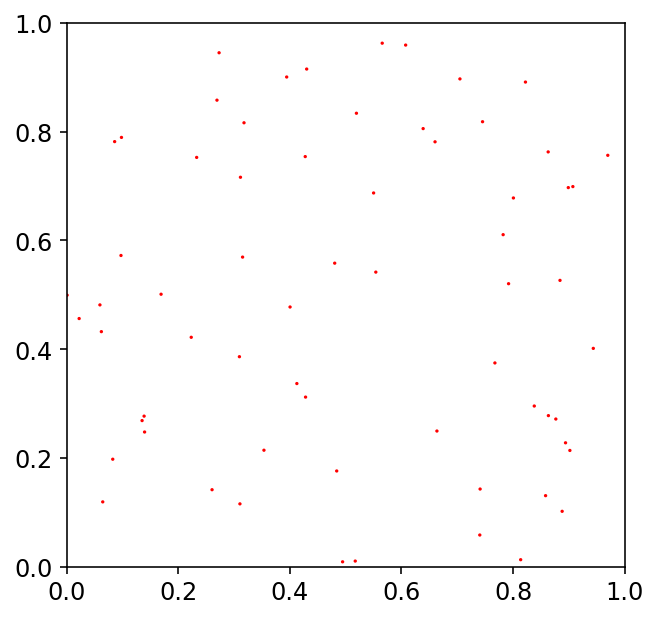

In [25]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
xred, yred = pos_initial[:,0], pos_initial[:,1]
circles_red = [plt.Circle((xi, yi), radius=particle_radius, linewidth=0) for xi,yi in zip(xred,yred)]
cred = matplotlib.collections.PatchCollection(circles_red, facecolors='red')
ax.add_collection(cred)
ax.set_xlim(0,1)
ax.set_ylim(0,1)
plt.show()

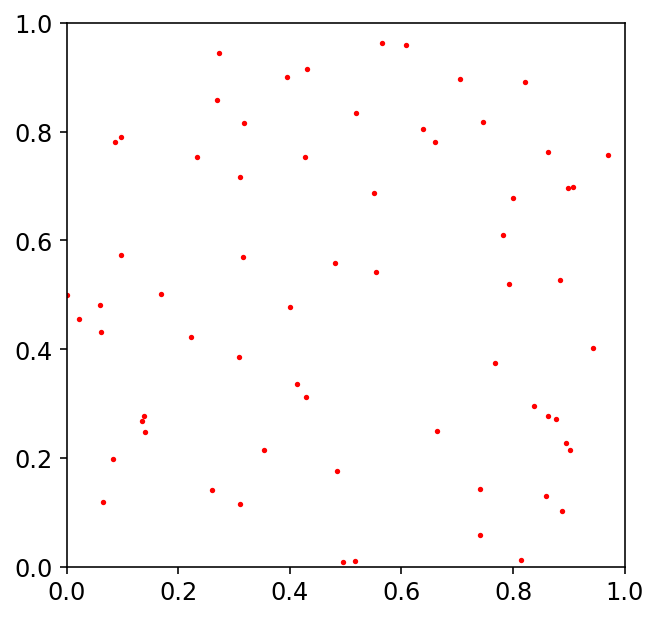

In [26]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.clear()
vmin = 0
vmax = 1
ax.set_xlim(0,1)
ax.set_ylim(0,1)
markersize = 2 * particle_radius * ax.get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = ax.plot([], [], 'o', color='red', markersize=markersize)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    return [red]



ani = animation.FuncAnimation(fig, animate, frames=500, interval=50, blit=True)

In [27]:
HTML(ani.to_jshtml())


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 1.2.1</span>

Maxwell-Boltzmann Distribution
Let's look at the final velocity distribution of the particles and compare it to Maxwell-Boltzmann in 2 Dimensions:

* $kT = KE_{avg} = \frac{1}{2}m\bar{v^2} \implies \boxed{\frac{m}{kT} = \frac{2}{\bar{v^2}}}$
* $\boxed{f(v) = \frac{m}{kT} v \exp\left(-\frac{m}{kT}\frac{v^2}{2} \right)}$

* The initial velocity will all be identical, corresponding to the temperature $T$
* Write a function for the fit function, and enter pdf value of f(100) (where unit is $m/s$)

In [28]:
v = np.linspace(0, 2000, 1001)

def maxwell_boltzmann(v):    
    a = 2/500**2
    fv = a*v*np.exp(-a*v**2 / 2)
    return fv

#print(np.where(v==100))    
#maxwell_boltzmann(v)[np.where(v==100)[0]]

In [29]:
#indices = np.arange(0,n_particles,1)
#idx_pair = np.array(list(itertools.combinations(indices,2)))
#collision_idx = which_pair_collides(distance_pairs(pos_initial, idx_pair))

In [30]:
#np.where(collision_idx==True)

In [31]:
#pos_initial_removed = np.delete(pos_initial, idx_pair[collision_idx][:,0], axis=0)

In [32]:
#n_particles = pos_initial_removed.shape[0]

In [33]:
np.random.seed(673720454)
n_particles = 400
pos_initial = np.random.rand(n_particles, 2)

particle_radius = 0.0002
vel_initial = np.zeros((n_particles,2))
thetas = np.random.rand(n_particles)* 2 * np.pi
vel_initial[:, 0] = np.cos(thetas) * 500
vel_initial[:, 1] = np.sin(thetas) * 500



673720454


In [34]:
# This can take a while...
pos_sim, vel_sim = simulate(pos_initial, vel_initial, 40000, 0.0000008)

In [37]:
#v = np.linspace(0, 2000, 1000)
#a = 2/500**2
#fv = a*v*np.exp(-a*v**2 / 2)

Text(0, 0.5, '# Particles')

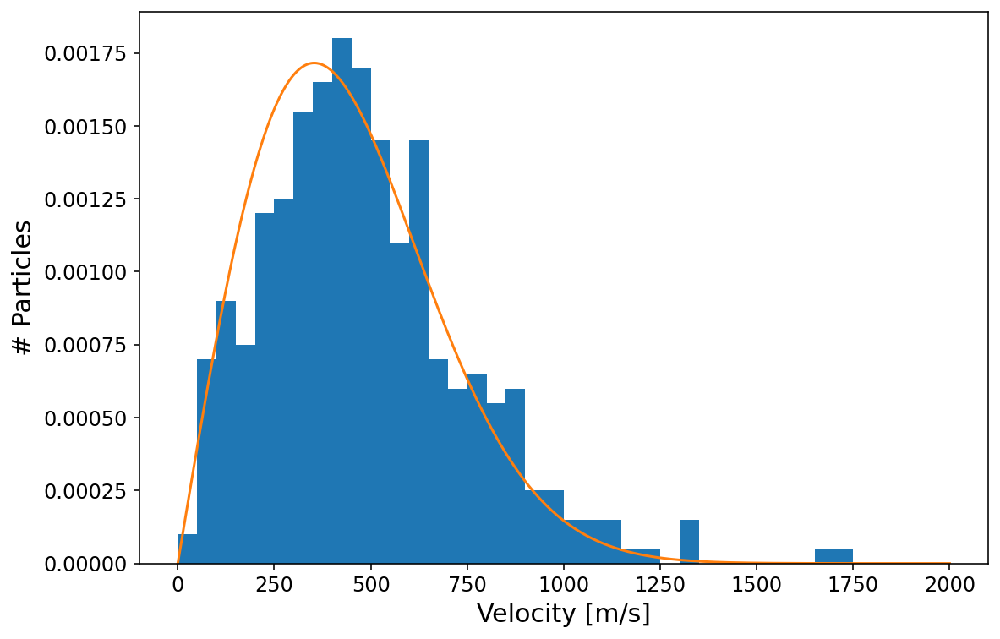

In [38]:

bins = np.linspace(0,2000,41)
plt.figure()
plt.hist(np.sqrt(np.sum(vel_sim[-1]**2, axis=1)), bins=bins, density=True)
plt.plot(v,maxwell_boltzmann(v))
plt.xlabel('Velocity [m/s]')
plt.ylabel('# Particles')



In [39]:
# with some simple simulation, we were able to obtain Maxwell-Boltzmann relation

In [40]:
# Use LMFIT to extract parameters?

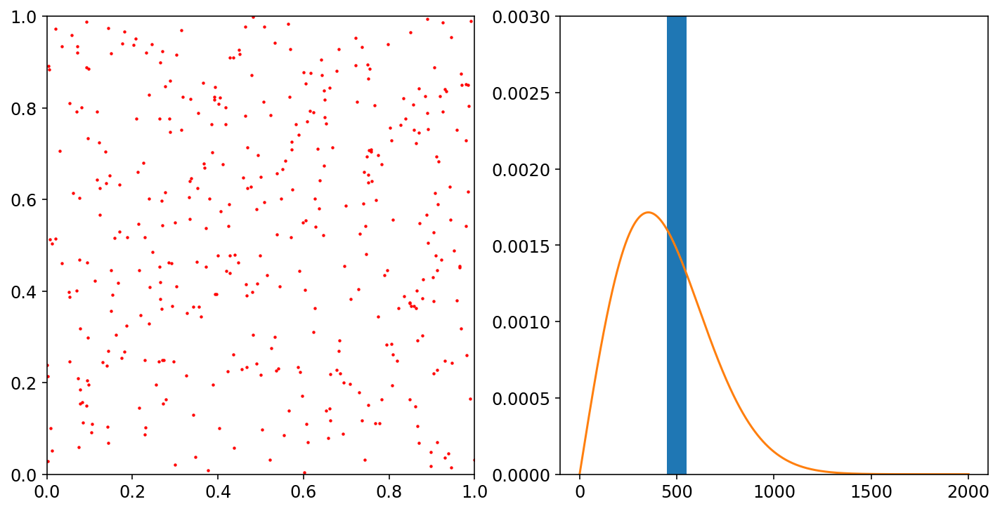

In [53]:
fig, axes = plt.subplots(1, 2, figsize=(12,6))
axes[0].clear()
vmin = 0
vmax = 1
axes[0].set_xlim(0,1)
axes[0].set_ylim(0,1)
markersize = 10*2 * particle_radius * axes[0].get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = axes[0].plot([], [], 'o', color='red', markersize=markersize)
n, bins, patches = axes[1].hist(np.sqrt(np.sum(vel_sim[0]**2, axis=1)), bins=bins, density=True)
axes[1].plot(v,fv)
axes[1].set_ylim(top=0.003)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    hist, _ = np.histogram(np.sqrt(np.sum(vel_sim[i]**2, axis=1)), bins=bins, density=True)
    for i, patch in enumerate(patches):
        patch.set_height(hist[i])
    return [red]

from itertools import chain
ani_hist = animation.FuncAnimation(fig, animate, frames=list(chain(range(100),range(100, 39500, 100), range(39500, 40000))), interval=200, blit=True)


In [54]:
HTML(ani_hist.to_jshtml())


Animation size has reached 20988451 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<!--start-block-->
<a name='section_4_2'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.2 Ideal Gas Law</h2>

| [Top](#section_4_0) | [Previous Section](#section_4_1) | [Problems](#exercises_4_3) | [Next Section](#section_4_3) |

<h3>Overview</h3>

Now with the setup we just completed, we will derive ideal gas relations. 
Ideal gas law combines Boyle's law and Charles's law and Gay-Lussac's law, and Avogadro's law to derive 
We will confirm each of them through molecular simulation. 

In real life, its easier to keep th

Firstly, we will check Gay-Lussac's law, which states that the pressure exerted by a given mass and constant volume of an ideal gas on the sides of its container is directly proportional to its absolute temperature.


We essentially want to show that

$$PV = Nk_B T$$

where $P$ is pressure, $V=L^3$ is the volume of a box, $N$ is the number of particles, and $k_B$ is Boltzmann's constant. Noting that $E = 3/2 k_B T$ (kinetic theory of gases) we can write $1/2 m v_{average}^2 = 3/2 k_B T$ or that

$$T = \frac{m}{3k_B}v_{average}^2$$

Since no energy is lost, $v_{average}$ will remain the same throughout the simulation (note we assume that all particles have same mass $m$ here). We can rewrite the right hand side (RHS) of the ideal gas law as

$$RHS = \frac{Nm}{3}v_{average}^2$$

In our billiard ball simulation, the RHS can be computed based on the initial state. We choose the number of particles $N$ and initial velocities $v$ and this can be computed. The purpose of the simulation will be to show that the $RHS$ is equal to $PV$ (which is computed based on balls hitting walls).

 The pressure is given by $P = F/(6L^2)$ where $F$ is the force and $L$ is the side length of the box. We just need to compute the imparted force. Noting that $F = \Delta p / \Delta t$, we can compute the force as follows:

 * We track particles that hit the walls of the box and compute the change of momentum $\Delta p_i$ given to the box at each time step.
 * The force is then $F = \sum_i |\Delta p_i| / t$ where $t$ is the length of time of the simulation.
 * Note that $p_i = mv_i$

 We can substitute this into $P$ and set $V=L^3$ to get

 $$LHS = \frac{mL \sum |\Delta v_i|}{6 \Delta t}$$

 So if we compute $RHS$ at the beginning of the simulation, run the simulation, and show that $LHS$ is equal, then we have effectively provided Monte Carlo based evidence for the ideal gas law. Since both are proportional to mass, we'll neglect $m$ and simply show that  $LHS/m = RHS/m$



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.1</span>

Write a function named `compute_delta_v` that takes 2 inputs: a velocity before collsion with the wall `vel_i`, the velocity after collision `vel_f`, and then returns the sum of the change of magnitude of all the collsions with the wall. 

$$\sum_i |\Delta v_i|$$

You can use your function in the ungraded "follow-up" part of this problem.

In [60]:
def compute_delta_v(vel_i, vel_f):
    #Your Code Here
    return np.sum(np.abs(vel_f - vel_i))

In [61]:
#Let's start computing macroscopic quantities based on the microscopic components

In [62]:
#def compute_pressure

Let's add this to our simulation code to save the sum of delta v as well

In [63]:
#Now let's edit our simulation to also keep track of delta v

In [69]:
def simulate(pos, vel, time_steps, dt):

    
    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    
    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))
    dv = np.zeros((time_steps))


    

    
    pos_simulated[0] = pos
    vel_simulated[0] = vel
    dv[0] = 0
    
    for i in range(1,time_steps):


        collision_idx = which_pair_collides(compute_distance_pairs(pos, idx_pair))
        v1f, v2f = pair_collision(pos[idx_pair[collision_idx][:,0]], pos[idx_pair[collision_idx][:,1]],
                                  vel[idx_pair[collision_idx][:,0]], vel[idx_pair[collision_idx][:,1]])

        vel[idx_pair[collision_idx][:,0]] = v1f
        vel[idx_pair[collision_idx][:,1]] = v2f


        #vel_before = vel.copy()
        
        vel_before = vel.copy()
        vel = wall_collision(pos, vel)

        #Uncomment this line
        delta_v = compute_delta_v(vel_before, vel)
        dv[i] = delta_v
        
        pos = pos + vel * dt
        

        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated, dv






In [73]:
npoints = 2000
pressure_list = []
v_list = np.array([0, 300, 400, 500])
for v_magnitude in [0,300,400,500]:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, 40000, 0.0000008)
    pressure = np.sum(dv_sim[-npoints:])/(4 * (npoints*0.0000008) )
    pressure_list.append(pressure)
    print(pressure)

0.0
22039510.222329985
37326758.89237416
61767017.45659955


In [76]:
v_list = np.array([0, 300, 400, 500])

T = v_list**2/(2*1.38e-23)

In [77]:
T

array([0.00000000e+00, 3.26086957e+27, 5.79710145e+27, 9.05797101e+27])

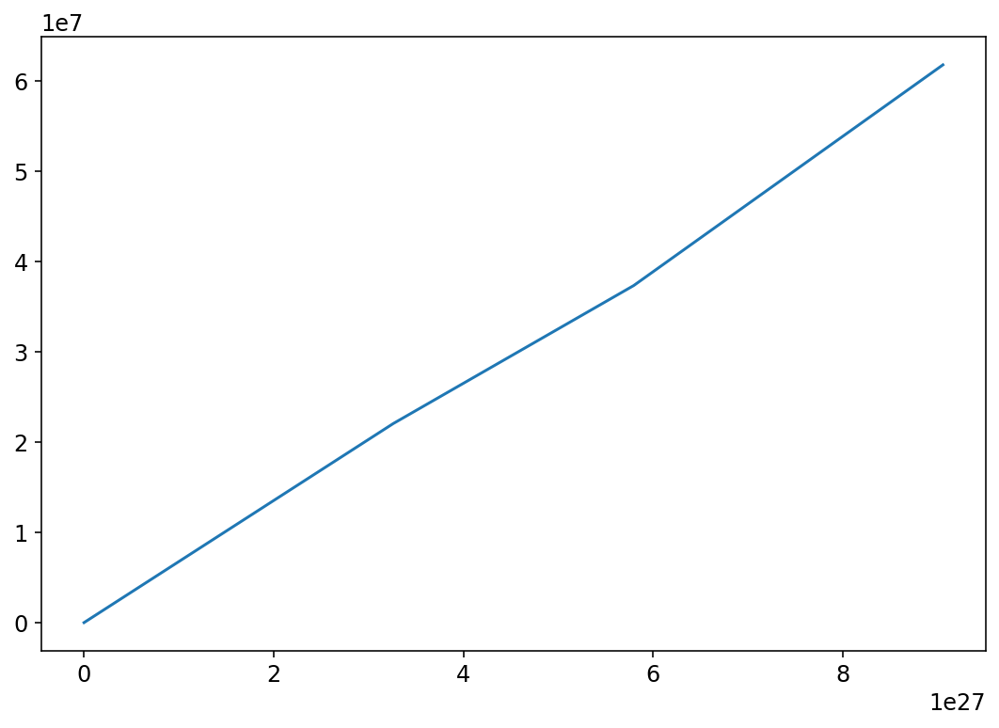

In [78]:
plt.plot(T, pressure_list)

Let's use lmfit to get the slope of this thing. Enter the slope of the fit after fitting times $10^{27}$  to three significant digit. 

As a next step, let's confirm Avogadro's Law, which states that 

Next, Let's check Boyle's Law.
In order to do that, we should be able to vary the volume by changing the side length variable `L` in the code.
Enter the pressure values for different V values below. 

In [ ]:
def wall_collision(pos, vel):
    # Your code goes here. 
    #collsion with the right wall 
    vel[pos[:, 0] > 1, 0] = -np.abs(vel[pos[:, 0] > 1, 0])

    #collision with the left wall 
    vel[pos[:, 0] < 0, 0] = np.abs(vel[pos[:, 0] < 0, 0])

    #collision with the top wall 
    vel[pos[:, 1] > 1, 1] = -np.abs(vel[pos[:, 1] > 1, 1])

    #collsion with the bottom wall 
    vel[pos[:, 1] < 0, 1] = np.abs(vel[pos[:, 1] < 0, 1])
    return vel 

In [ ]:
npoints = 2000
pressure_list = []
v_list = np.array([0, 300, 400, 500])
for v_magnitude in [0,300,400,500]:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, 40000, 0.0000008)
    pressure = np.sum(dv_sim[-npoints:])/(4 * (npoints*0.0000008) )
    pressure_list.append(pressure)
    print(pressure)

In [ ]:
v_magnitude = 500
vel_initial = np.zeros((n_particles,2))
thetas = np.random.rand(n_particles)* 2 * np.pi
vel_initial[:, 0] = np.cos(thetas) * v_magnitude
vel_initial[:, 1] = np.sin(thetas) * v_magnitude



In [ ]:
pos_sim, vel_sim, dv_sim = simulate(pos_initial_removed, vel_initial, 40000, 0.0000008, 1)

In [264]:
np.sum(dv_sim[-npoints:])

620506.2870956544

In [ ]:
# by fitting you get the slope (slope, error propagation makes it unusuable> what am i thinking of, maybeLHCO)

In [148]:
# With this simple code we can replicate the Boltzmann distribution

In [99]:
n_particles = 300
pos_initial = np.random.rand(n_particles, 2)

#ixa = pos_initial[:,0]>0.5 #right
#ixb = pos_initial[:,0]<=0.5 #left



particle_radius = 0.0002


In [100]:
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))
collision_idx = which_pair_collides(distance_pairs(pos_initial, idx_pair))

In [101]:
np.where(collision_idx==True)

(array([], dtype=int64),)

In [102]:
pos_initial_removed = np.delete(pos_initial, idx_pair[collision_idx][:,0], axis=0)

In [103]:
n_particles = pos_initial_removed.shape[0]

In [104]:
vel_initial = np.zeros((n_particles,2))
thetas = np.random.rand(n_particles)* 2 * np.pi
vel_initial[:, 0] = np.cos(thetas) * 500
vel_initial[:, 1] = np.sin(thetas) * 500



In [105]:
pos_sim, vel_sim = simulate(pos_initial_removed, vel_initial, 60000, 0.0000008, 1)

In [106]:
v = np.linspace(0, 2000, 1000)
a = 2/500**2
fv = a*v*np.exp(-a*v**2 / 2)

Text(0, 0.5, '# Particles')

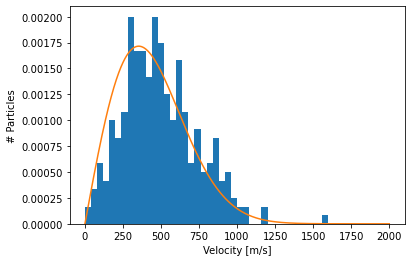

In [108]:

bins = np.linspace(0,2000,51)
plt.figure()
plt.hist(np.sqrt(np.sum(vel_sim[-1]**2, axis=1)), bins=bins, density=True)
plt.plot(v,fv)
plt.xlabel('Velocity [m/s]')
plt.ylabel('# Particles')



In [134]:
n_particles = 200
pos_initial = np.random.rand(n_particles, 2)

#ixa = pos_initial[:,0]>0.5 #right
#ixb = pos_initial[:,0]<=0.5 #left



particle_radius = 0.0002


In [135]:
vel_initial = np.zeros((n_particles,2))
thetas = np.random.rand(n_particles)* 2 * np.pi
vel_initial[:, 0] = np.cos(thetas) * 500
vel_initial[:, 1] = np.sin(thetas) * 500



In [136]:
pos_sim, vel_sim = simulate(pos_initial, vel_initial, 80000, 0.0000008, 1)

In [137]:
v = np.linspace(0, 2000, 1000)
a = 2/500**2
fv = a*v*np.exp(-a*v**2 / 2)

Text(0, 0.5, '# Particles')

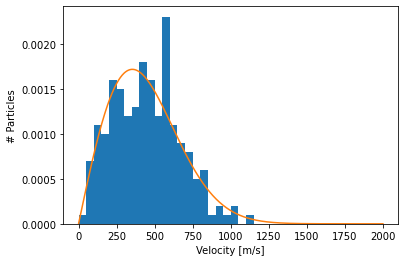

In [138]:

bins = np.linspace(0,2000,41)
plt.figure()
plt.hist(np.sqrt(np.sum(vel_sim[-1]**2, axis=1)), bins=bins, density=True)
plt.plot(v,fv)
plt.xlabel('Velocity [m/s]')
plt.ylabel('# Particles')

